<a href="https://colab.research.google.com/github/paolitacute/Computer-Vision-Project-3/blob/main/Object_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **YOLO (https://arxiv.org/pdf/1506.02640)**

- models detection as a regression problem
- divides the image into an $S \times S$ grid
- for each grid cell predicts B bounding boxes, confidence for those boxes,
and C class probabilities
   - predictions are encoded as an $S \times S \times (B * 5 + C)$ tensor
   - normalize the bounding box width and height by the image width and height so that they fall between 0 and 1
   - parametrize the bounding box x and y coordinates to be offsets of a particular grid cell location so they are also bounded between 0 and 1

## **Dataset**

- https://drive.google.com/file/d/1ZblvuF_2JEd3e26Y-8DoeB3l44oVAOOW/view?usp=sharing

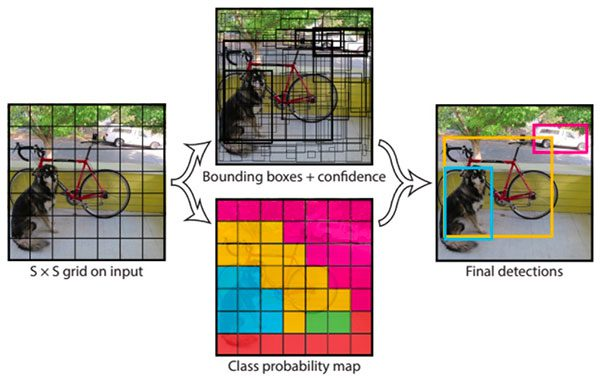

In [ ]:
import os
import cv2
import torch
from tqdm import tqdm
import torchvision
import numpy as np
import pandas as pd
from google.colab.patches import cv2_imshow

In [ ]:
class CarDataset(torch.utils.data.Dataset):
  def __init__(self):
    self.path = '/content/drive/MyDrive/ComputerVision/training_images'

    df = pd.read_csv('/content/drive/MyDrive/ComputerVision/training_images.csv')

    ann = {}
    for index, row in df.iterrows():
      filename = row['image']
      if filename not in ann:
        ann[filename] = []

      ann[filename].append([row['xmin'], row['ymin'], row['xmax'], row['ymax']])

    self.images = list(ann.keys())
    self.boxes = [val for key,val in ann.items()]

    # imagenet color normalization
    self.transforms = torchvision.transforms.Compose([
      torchvision.transforms.ToTensor(),
      torchvision.transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

  def __len__(self):
      return len(self.images)

  def __getitem__(self, idx):
    filename = self.images[idx]

    img = cv2.imread(
      os.path.join(
        '/content/drive/MyDrive/ComputerVision/training_images',
        filename
        ),
      cv2.IMREAD_COLOR
      )
    h, w, c = img.shape
    siz = min(h, w)

    # resize image to 224x224 and crop center square
    img = cv2.resize(
      img[(h-siz)//2:(h-siz)//2+siz, (w-siz)//2:(w-siz)//2+siz],
      (224,224)
      )

    gt = np.zeros((5,7,7), dtype=np.float32)

    for box in self.boxes[idx]:
      # center coordinate in resized image
      x1, y1, x2, y2 = box
      x = int(((x1+x2)/2 - (w-siz)//2) * 224.0/siz + 0.5)
      y = int(((y1+y2)/2 - (h-siz)//2) * 224.0/siz + 0.5)

      i = y//32
      j = x//32

      # box dimensions in resized image
      bh = (y2-y1) * 224.0/siz
      bw = (x2-x1) * 224.0/siz

      if i >= 0 and i < 7 and j >= 0 and j < 7:
        gt[4,i,j] = 1.0
        gt[0,i,j] = (x%32)/31.0
        gt[1,i,j] = (y%32)/31.0
        gt[2,i,j] = bw/224.0
        gt[3,i,j] = bh/224.0

    return self.transforms(img), gt

1.0 16 130 63 26


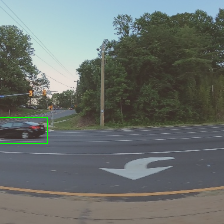

1.0 195 112 49 16


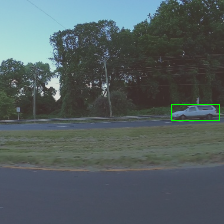

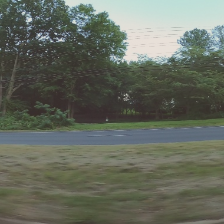

1.0 137 122 73 32


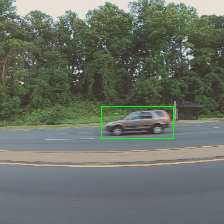

1.0 211 114 73 29


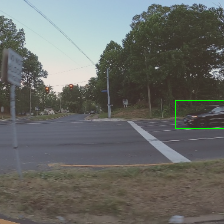

1.0 62 136 108 43


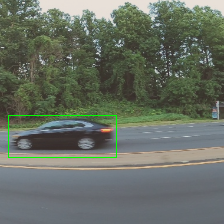

1.0 36 127 72 27


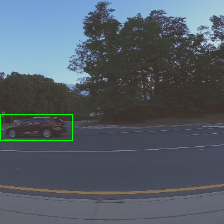

1.0 105 127 67 29


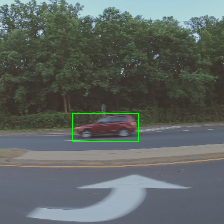

1.0 205 122 73 28


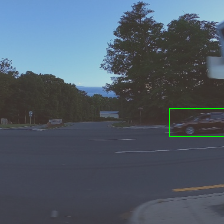

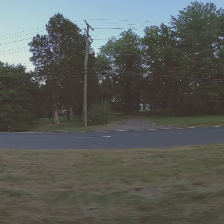

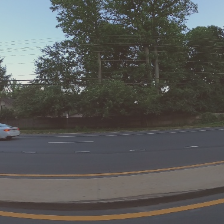

1.0 216 116 79 42


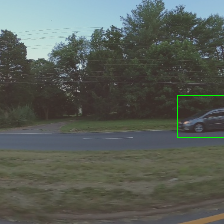

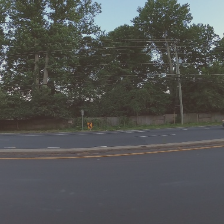

1.0 35 126 59 20


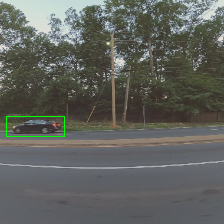

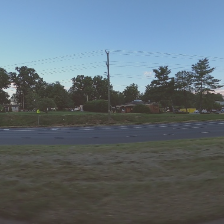

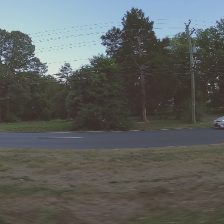

In [ ]:
dataset = CarDataset()
dataloader = torch.utils.data.DataLoader(dataset, batch_size=16, shuffle=True)

for x, y in dataloader:
  # batch visualization
  for j in range(len(x)):
    # convert pixel color to 0-255
    img = (np.transpose(x[j].numpy(), (1,2,0))*40.0+127.0).astype(np.uint8).copy()
    for ki in range(7):
      for kj in range(7):
        k = ki*7+kj
        px, py, pw, ph, pc = y[j,:,k//7,k%7]
        if pc.item() > 0.3:
          # center of bounding box
          cx = (k%7)*32 + int(px*31+0.5)
          cy = (k//7)*32 + int(py*31+0.5)
          # dimensions of bounding box
          w = int(pw*224+0.5)
          h = int(ph*224+0.5)
          print(pc.item(), cx, cy, w, h)
          cv2.rectangle(img, (cx-w//2,cy-h//2), (cx+w//2,cy+h//2), (0,255,0), 1)
    cv2_imshow(img)

  break


# **Using pretrained models**

- All models: https://docs.pytorch.org/vision/main/models.html
- ResNet-18: https://docs.pytorch.org/vision/main/models/generated/torchvision.models.resnet18.html
- Get output of intermediate layer: https://docs.pytorch.org/vision/main/generated/torchvision.models.feature_extraction.create_feature_extractor.html

In [ ]:
class CarDetector(torch.nn.Module):
  def __init__(self):
    super().__init__()
    backbone = torchvision.models.resnet.resnet18()
    self.backbone = torchvision.models._utils.IntermediateLayerGetter(backbone, return_layers={'layer4': 'feat4'})
    self.linear = torch.nn.Conv2d(512, 5, (1,1))

  def forward(self, x):
    x = self.backbone(x)
    x = self.linear(x['feat4'])
    return torch.sigmoid(x)

In [ ]:
model = CarDetector().cuda()

for x, y in dataloader:
  with torch.no_grad():
    output = model(x.cuda())
    print(output.shape)
  break

torch.Size([16, 5, 7, 7])


Epoch 0


100%|██████████| 23/23 [00:02<00:00,  8.70it/s]

0.06212408136090507
1.0 140 120 27 18
0.46206414699554443 134 107 2 1


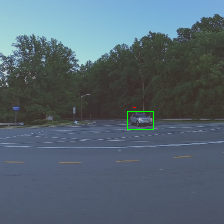

1.0 16 125 58 25
0.6659160256385803 6 111 2 2


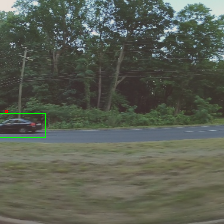

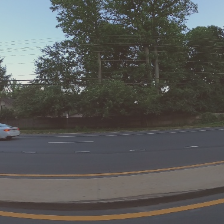

Epoch 1


100%|██████████| 23/23 [00:02<00:00,  8.71it/s]

0.029840354888659458
1.0 111 124 66 26
0.9363448619842529 119 117 41 16


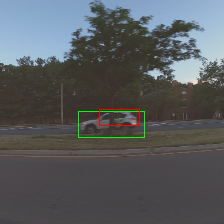

1.0 168 127 106 35
0.34677666425704956 168 102 11 6
0.42478278279304504 164 131 11 4


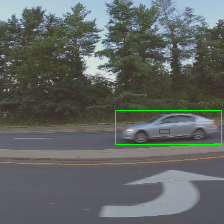

0.4563237130641937 38 102 8 6


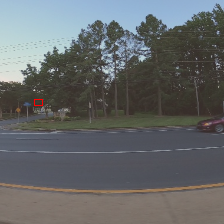

Epoch 2


100%|██████████| 23/23 [00:02<00:00,  8.80it/s]

0.023082163579680997
1.0 45 125 54 18
0.9200037717819214 45 120 43 35
1.0 179 124 69 27
0.9759174585342407 177 124 78 36


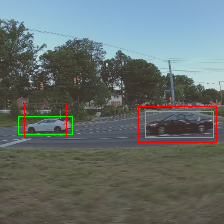

1.0 113 124 59 24
0.9713563323020935 112 124 65 32


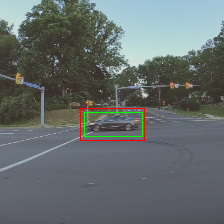

1.0 62 136 108 43
0.5044462084770203 36 130 22 4
0.6340197324752808 68 130 26 3


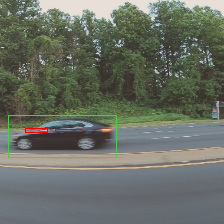

Epoch 3


100%|██████████| 23/23 [00:02<00:00,  8.43it/s]

0.018067665610705382


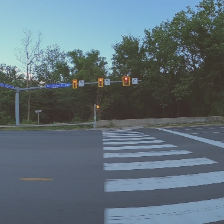

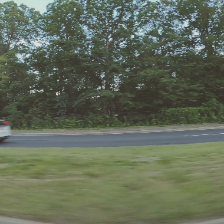

1.0 201 121 78 25
0.9867842793464661 209 126 134 50


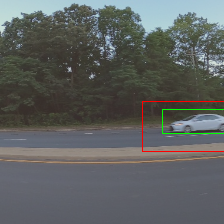

Epoch 4


100%|██████████| 23/23 [00:02<00:00,  8.68it/s]

0.0164109426246875
1.0 43 123 22 23
0.9711325764656067 39 123 34 12


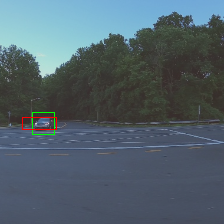

1.0 1 126 54 23
0.9274303913116455 9 120 44 21
1.0 176 121 69 35
0.9909489750862122 174 122 43 18


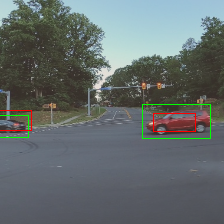

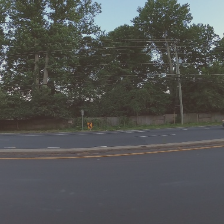

Epoch 5


100%|██████████| 23/23 [00:02<00:00,  8.73it/s]

0.014386652735993266
1.0 117 124 72 26
0.9867167472839355 118 124 41 12


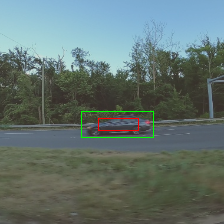

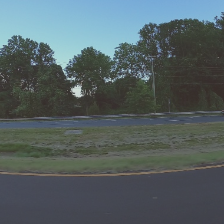

1.0 0 123 65 26
0.949065625667572 11 119 39 20
0.42409271001815796 198 102 6 3


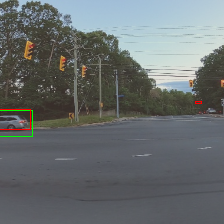

Epoch 6


100%|██████████| 23/23 [00:02<00:00,  8.61it/s]

0.01172396668192485
1.0 92 114 15 16
0.6688808798789978 76 109 9 7


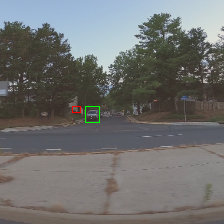

1.0 104 124 85 31
0.9397189617156982 104 120 40 21


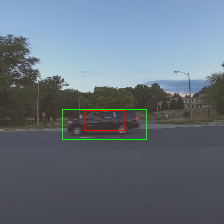

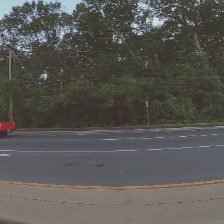

Epoch 7


100%|██████████| 23/23 [00:02<00:00,  8.60it/s]

0.007360509293072898
1.0 20 127 51 22
0.9213311672210693 17 120 33 19
1.0 102 128 99 41
0.8664793968200684 106 132 50 23


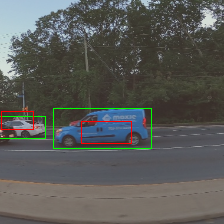

1.0 205 122 73 28
0.9970380067825317 214 124 107 33


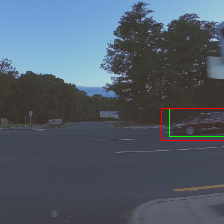

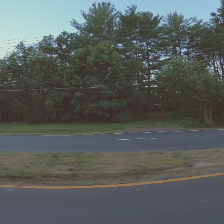

Epoch 8


100%|██████████| 23/23 [00:02<00:00,  8.46it/s]

0.0067448906559983025


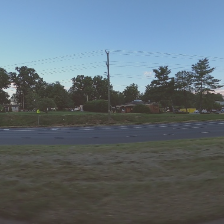

1.0 196 113 95 51
0.9439866542816162 201 115 45 19


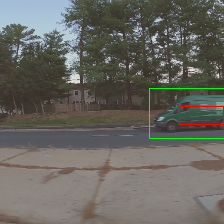

1.0 115 128 108 40
0.30343711376190186 102 129 9 1


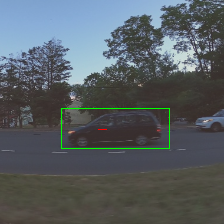

Epoch 9


100%|██████████| 23/23 [00:02<00:00,  8.74it/s]

0.007873063471735171
1.0 86 125 78 30
0.9993410706520081 85 125 89 40


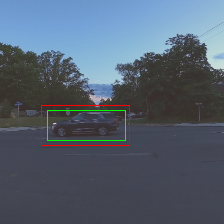

1.0 140 120 27 18
0.62870854139328 136 111 16 8


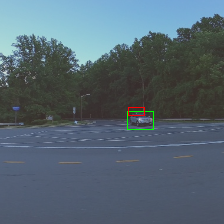

1.0 17 132 88 32
0.8737632036209106 7 130 36 14


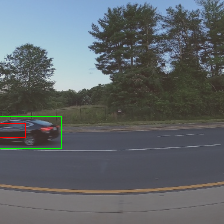

Epoch 10


100%|██████████| 23/23 [00:02<00:00,  8.69it/s]

0.005517515217197006
0.6162804961204529 140 110 32 18
1.0 2 135 98 33
0.9740065336227417 7 130 88 19
1.0 150 129 69 26
0.8021669387817383 146 129 41 16


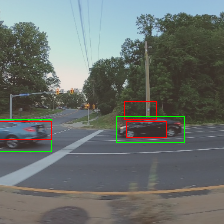

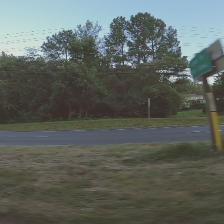

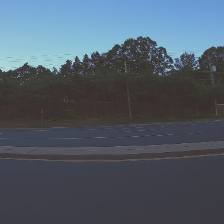

Epoch 11


100%|██████████| 23/23 [00:02<00:00,  8.63it/s]

0.005926398565466313


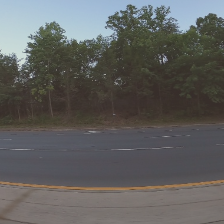

1.0 19 124 47 22
0.9979617595672607 16 125 31 16


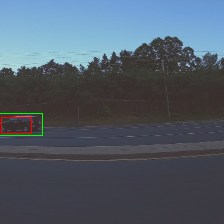

1.0 109 122 67 23
0.9999630451202393 113 125 54 15


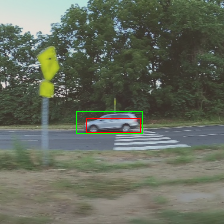

Epoch 12


100%|██████████| 23/23 [00:02<00:00,  8.40it/s]

0.002932295663808675
1.0 18 123 52 21
0.6560047268867493 11 117 11 7
1.0 124 119 58 24
0.9989897608757019 119 126 57 32
1.0 55 128 65 25
0.7950294017791748 49 129 37 15


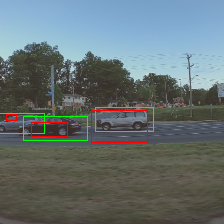

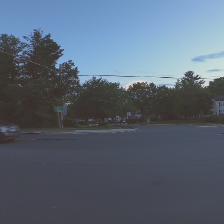

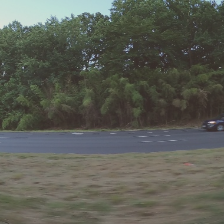

Epoch 13


100%|██████████| 23/23 [00:02<00:00,  8.60it/s]

0.004024009002656068
1.0 186 120 55 21
0.9992743134498596 186 120 47 27


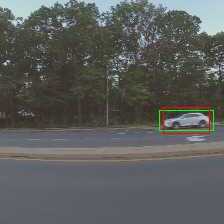

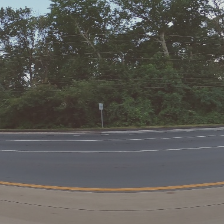

1.0 150 122 42 17
0.9921694397926331 148 121 34 15


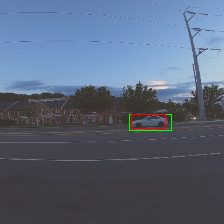

Epoch 14


100%|██████████| 23/23 [00:02<00:00,  8.68it/s]

0.002386901130312649
1.0 32 124 59 23
0.998630702495575 37 124 75 37


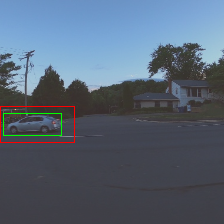

1.0 68 121 64 24
0.9996956586837769 70 120 90 38


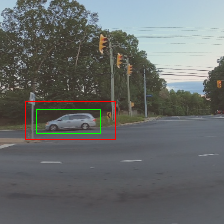

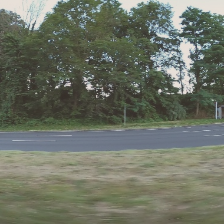

Epoch 15


100%|██████████| 23/23 [00:02<00:00,  8.63it/s]

0.0029661653527949493


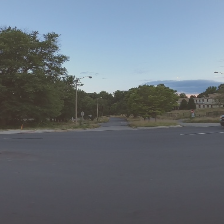

1.0 61 118 25 15
0.998189389705658 58 120 38 19
1.0 157 131 103 33
0.9983935952186584 153 131 95 34


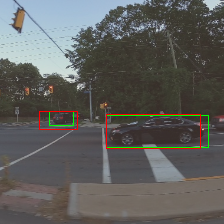

1.0 179 124 52 28
0.9999548196792603 182 126 93 33


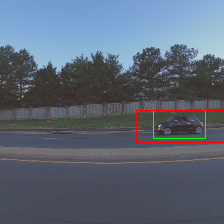

Epoch 16


100%|██████████| 23/23 [00:02<00:00,  8.56it/s]

0.0017313341288726128
1.0 103 126 76 33
0.9999513626098633 104 125 114 44


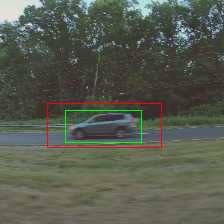

1.0 44 127 100 35
0.9998553991317749 47 123 81 37


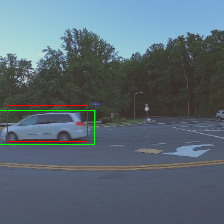

1.0 57 127 72 29
0.9999462366104126 51 123 100 43


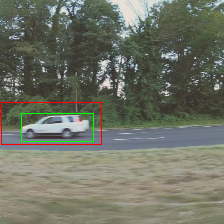

Epoch 17


100%|██████████| 23/23 [00:02<00:00,  8.32it/s]

0.0014649750272561189


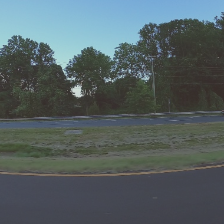

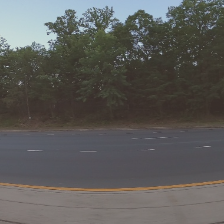

1.0 20 127 51 22
0.9996345043182373 11 126 57 23
0.5314792394638062 77 105 12 5
1.0 102 128 99 41
0.9991841912269592 98 132 65 27


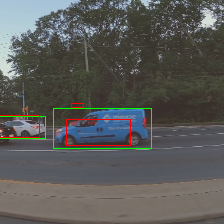

Epoch 18


100%|██████████| 23/23 [00:02<00:00,  8.54it/s]

0.0053737883623082025
1.0 66 125 65 23


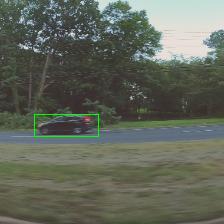

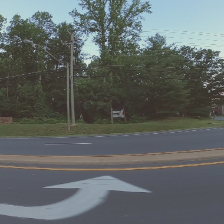

1.0 49 123 60 21
0.999901533126831 47 120 72 27


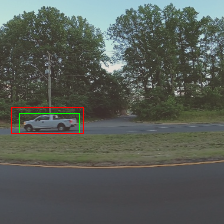

Epoch 19


100%|██████████| 23/23 [00:02<00:00,  8.52it/s]

0.008535784603420483
1.0 48 122 46 22
0.9799464344978333 45 113 21 11


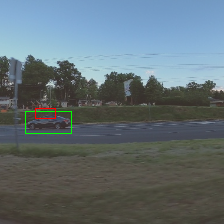

1.0 106 121 47 17
0.992100179195404 105 118 47 26
1.0 162 123 72 24
0.8327106237411499 168 111 26 12
1.0 220 117 49 19
0.9882500171661377 207 116 57 33


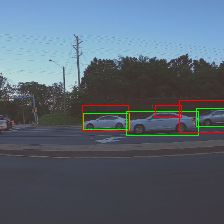

1.0 145 121 70 30
0.9594902396202087 143 118 49 22


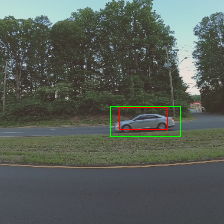

Epoch 20


100%|██████████| 23/23 [00:02<00:00,  8.72it/s]

0.005278396926334371
1.0 65 128 75 27


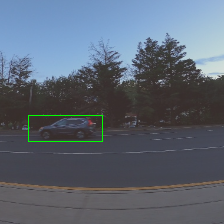

1.0 188 120 73 27
0.9987990856170654 183 123 100 49


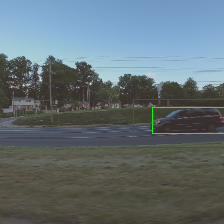

1.0 181 123 76 30
0.9999274015426636 178 125 87 26
1.0 0 129 54 19


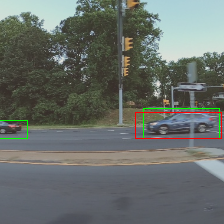

Epoch 21


100%|██████████| 23/23 [00:02<00:00,  8.31it/s]

0.005837574418958115
1.0 217 121 76 28
0.9997318387031555 212 126 73 20


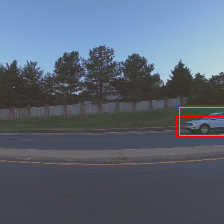

1.0 57 119 66 25
0.9976258873939514 49 124 50 25


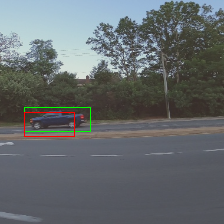

1.0 126 117 32 16
0.9963384866714478 119 120 28 12


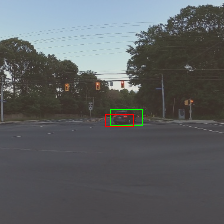

Epoch 22


100%|██████████| 23/23 [00:02<00:00,  8.42it/s]

0.0019333874073629925


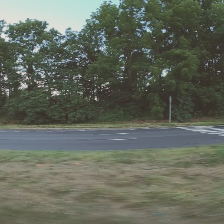

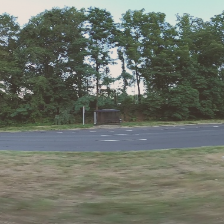

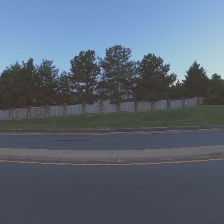

Epoch 23


100%|██████████| 23/23 [00:02<00:00,  8.56it/s]

0.0007925292517503966
1.0 39 130 95 39
0.9935374855995178 36 130 88 40


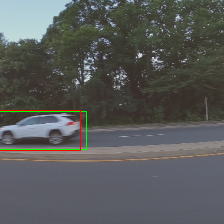

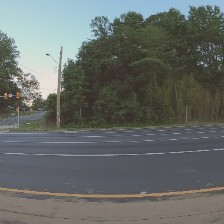

1.0 37 127 66 25
0.9993155002593994 41 126 59 24


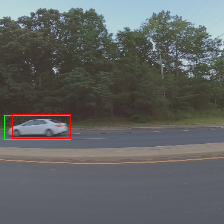

Epoch 24


100%|██████████| 23/23 [00:02<00:00,  8.53it/s]

0.0004465502184441151


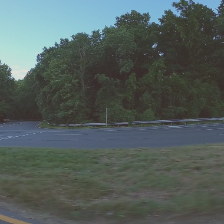

1.0 65 118 16 12
0.9997178912162781 66 119 29 14


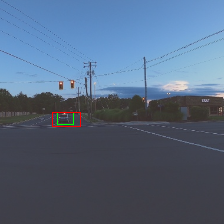

1.0 211 114 73 29
0.9999431371688843 214 115 80 32


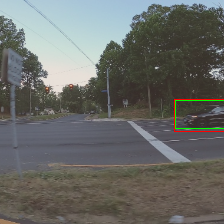

Epoch 25


100%|██████████| 23/23 [00:02<00:00,  8.39it/s]

0.00021019721411310297


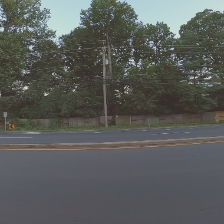

1.0 160 128 101 39
0.9984307885169983 162 130 95 38


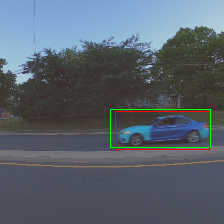

1.0 140 124 61 26
0.9998593330383301 139 122 63 27
1.0 78 132 110 36
0.9998857975006104 78 130 104 38


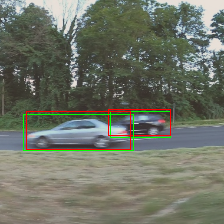

Epoch 26


100%|██████████| 23/23 [00:02<00:00,  8.30it/s]

0.00014966677427646178


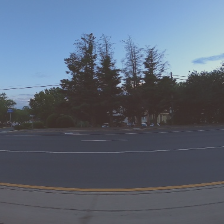

1.0 99 123 71 32
0.9999841451644897 100 123 75 28


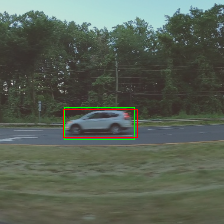

1.0 16 130 63 26
0.9985017776489258 12 136 71 31


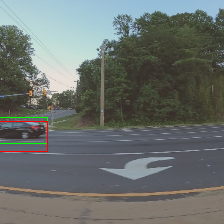

Epoch 27


100%|██████████| 23/23 [00:02<00:00,  8.56it/s]

0.00013569991587365107


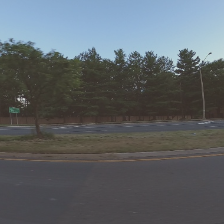

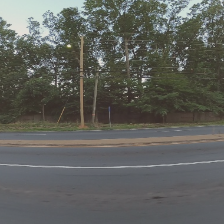

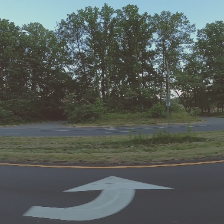

Epoch 28


100%|██████████| 23/23 [00:02<00:00,  8.59it/s]

0.00011384407685988623
1.0 90 122 72 35
0.999994158744812 89 125 87 31


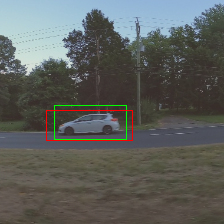

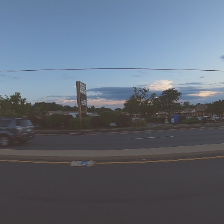

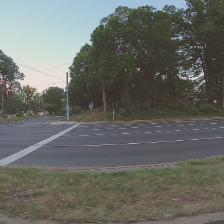

Epoch 29


100%|██████████| 23/23 [00:02<00:00,  8.61it/s]

9.215322263670437e-05
1.0 24 123 66 28
0.9996875524520874 21 124 59 22


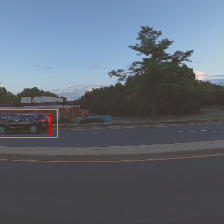

1.0 38 121 53 24
0.9998987913131714 36 123 60 26


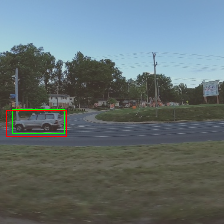

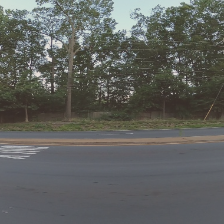

Epoch 30


100%|██████████| 23/23 [00:02<00:00,  8.33it/s]

9.206393034496021e-05


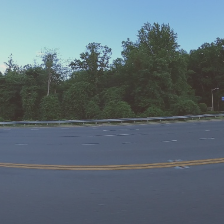

1.0 200 120 64 32
0.9999703168869019 203 120 62 32
1.0 66 129 102 40
0.9998835325241089 68 130 94 41


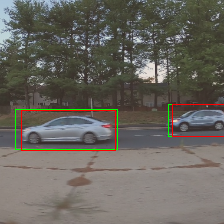

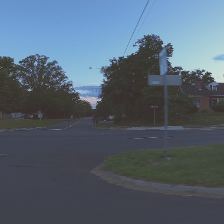

Epoch 31


100%|██████████| 23/23 [00:02<00:00,  8.46it/s]

7.522424098367438e-05
1.0 168 120 122 55
0.9998946189880371 169 123 130 70


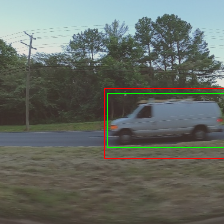

1.0 29 122 66 29
0.9999760389328003 28 123 64 31


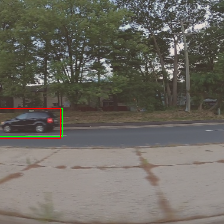

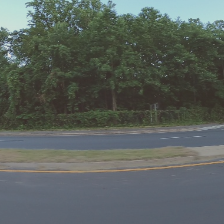

Epoch 32


100%|██████████| 23/23 [00:02<00:00,  8.65it/s]

6.60687163990983e-05


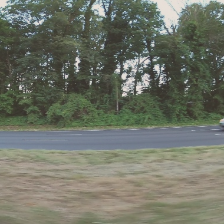

1.0 125 123 84 31
0.9999158382415771 124 124 77 30


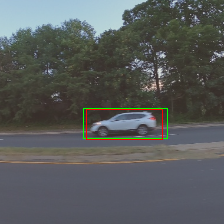

1.0 205 122 73 28
0.9999427795410156 206 121 68 27


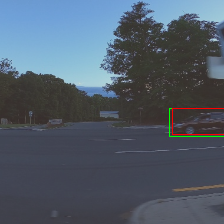

Epoch 33


100%|██████████| 23/23 [00:02<00:00,  8.61it/s]

7.134188553723304e-05


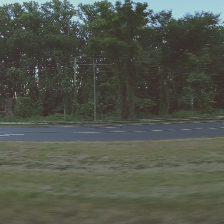

1.0 77 124 62 26
0.9999957084655762 72 125 69 27


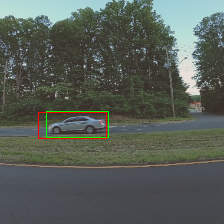

1.0 186 120 55 21
0.9998488426208496 186 120 54 25


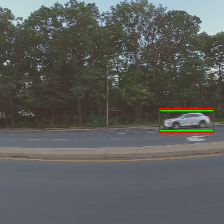

Epoch 34


100%|██████████| 23/23 [00:02<00:00,  8.54it/s]

6.237979758462525e-05
1.0 35 126 59 20
0.9998568296432495 34 126 64 22


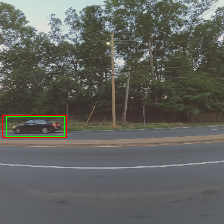

1.0 137 126 58 25
0.9989854693412781 138 125 67 22


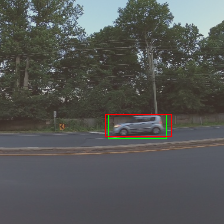

1.0 24 123 66 28
0.9998018145561218 25 124 68 23


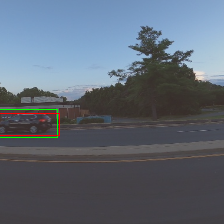

Epoch 35


100%|██████████| 23/23 [00:02<00:00,  8.37it/s]

6.434579763267918e-05
1.0 91 121 71 27
0.9999982118606567 90 121 53 24


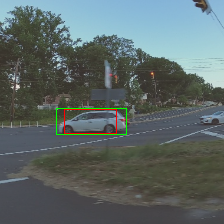

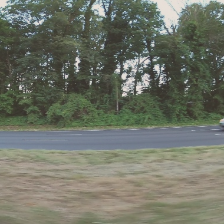

1.0 92 114 15 16
0.9999456405639648 87 115 19 15


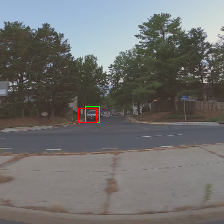

Epoch 36


100%|██████████| 23/23 [00:02<00:00,  8.54it/s]

5.666608210405052e-05


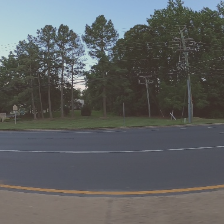

1.0 86 127 67 27
0.9999873638153076 88 125 84 34


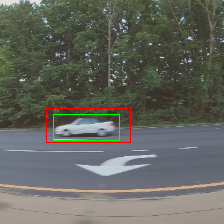

1.0 16 126 59 25
0.9999496936798096 13 126 70 32


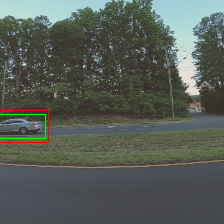

Epoch 37


100%|██████████| 23/23 [00:02<00:00,  8.59it/s]

4.975946111422356e-05


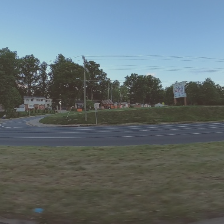

1.0 85 127 56 26
0.9999258518218994 84 124 49 17


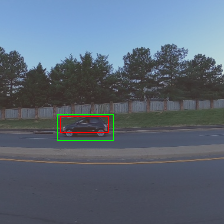

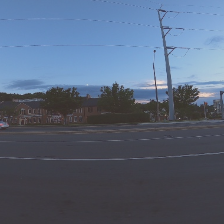

Epoch 38


100%|██████████| 23/23 [00:02<00:00,  8.48it/s]

4.539103824556704e-05
1.0 39 119 53 19
0.9999938011169434 40 119 64 21


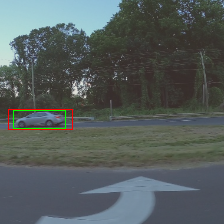

1.0 44 119 18 13
0.999987006187439 45 118 28 14


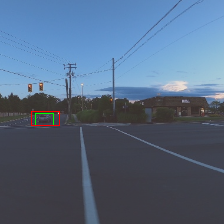

1.0 38 121 53 24
0.9999030828475952 38 122 62 24


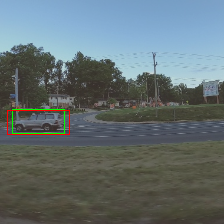

Epoch 39


100%|██████████| 23/23 [00:02<00:00,  8.20it/s]

5.067384296600484e-05
1.0 96 132 93 36
0.9998716115951538 100 136 104 46


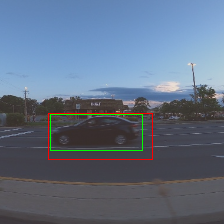

1.0 207 128 93 37
0.998170018196106 207 130 89 34


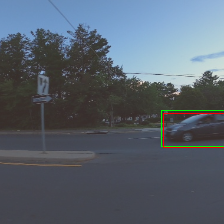

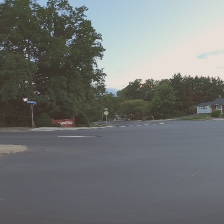

Epoch 40


100%|██████████| 23/23 [00:02<00:00,  8.40it/s]

5.896251090946506e-05


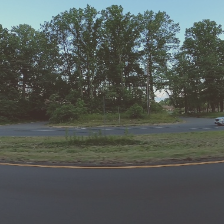

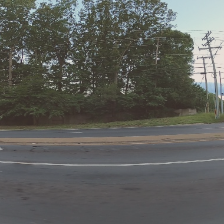

1.0 216 116 79 42
0.9999946355819702 214 119 73 33


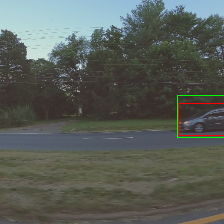

Epoch 41


100%|██████████| 23/23 [00:02<00:00,  8.57it/s]

4.557352930651573e-05


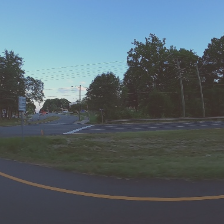

1.0 140 120 27 18
0.9999979734420776 141 121 45 23


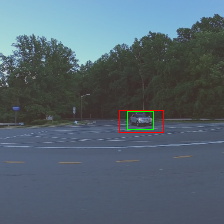

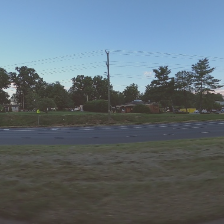

Epoch 42


100%|██████████| 23/23 [00:02<00:00,  8.63it/s]

3.6787356293643825e-05
1.0 72 114 11 11
0.9996912479400635 68 116 16 13
1.0 89 132 107 34
0.9999765157699585 88 130 100 30


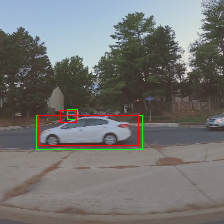

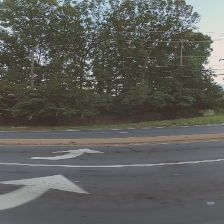

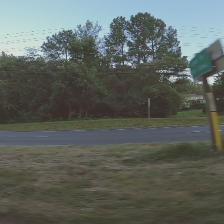

Epoch 43


100%|██████████| 23/23 [00:02<00:00,  8.46it/s]

3.451908757953156e-05


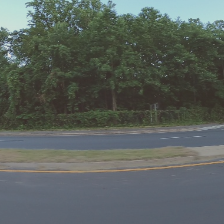

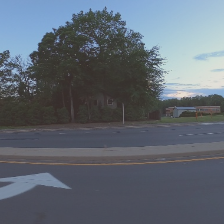

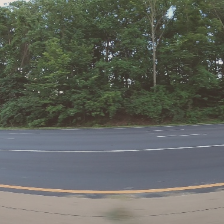

Epoch 44


100%|██████████| 23/23 [00:02<00:00,  8.34it/s]

3.572963072181902e-05
1.0 53 124 62 22
0.999981164932251 53 124 57 21
1.0 149 119 52 22
0.9990723133087158 149 117 38 12


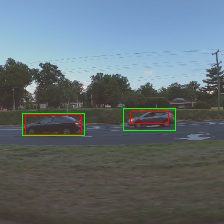

1.0 140 124 61 26
0.9998182654380798 140 124 53 23
1.0 78 132 110 36
0.9999825954437256 78 132 101 36


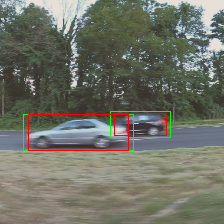

1.0 145 121 70 30
0.999932050704956 146 121 63 23


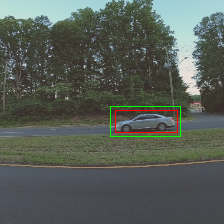

Epoch 45


100%|██████████| 23/23 [00:02<00:00,  8.70it/s]

4.384152302720948e-05
1.0 201 117 62 23
0.999997615814209 203 116 73 25


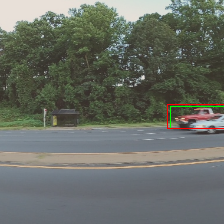

1.0 61 118 25 15
0.9986371397972107 60 117 20 12
1.0 157 131 103 33
0.9994670748710632 156 131 109 32


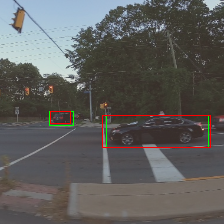

1.0 177 111 20 14
0.9966189861297607 178 112 24 15
1.0 205 117 27 31
0.9989314675331116 205 117 34 27


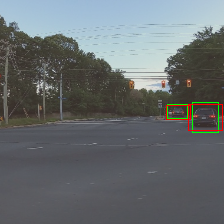

Epoch 46


100%|██████████| 23/23 [00:02<00:00,  8.60it/s]

4.49121646891834e-05
1.0 62 136 108 43
0.9999821186065674 61 136 103 49


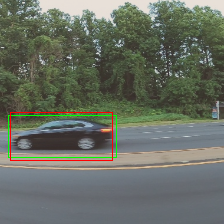

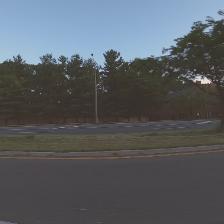

1.0 65 118 16 12
0.9998801946640015 65 118 18 18


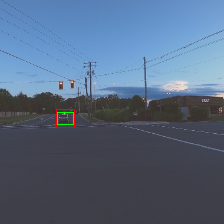

Epoch 47


100%|██████████| 23/23 [00:02<00:00,  8.71it/s]

3.535524402927283e-05


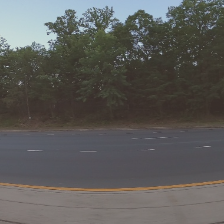

1.0 53 115 22 17
0.9999680519104004 54 115 32 15
1.0 97 124 72 36
0.9990548491477966 98 124 72 29
1.0 185 125 97 43
0.9999508857727051 184 125 105 32


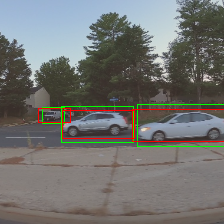

1.0 90 126 69 28
0.9993162155151367 89 125 71 24


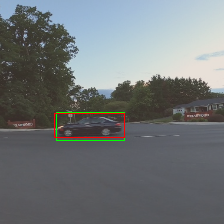

Epoch 48


100%|██████████| 23/23 [00:02<00:00,  8.49it/s]

3.3345473560114876e-05
1.0 117 124 72 26
0.9999954700469971 121 124 56 22


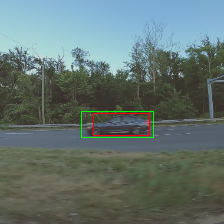

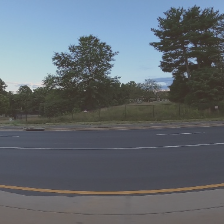

1.0 132 122 62 23
0.9999980926513672 132 123 55 22


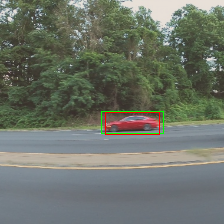

Epoch 49


100%|██████████| 23/23 [00:02<00:00,  8.18it/s]

2.7803755627879266e-05
1.0 119 124 74 27
0.9999932050704956 120 125 76 26


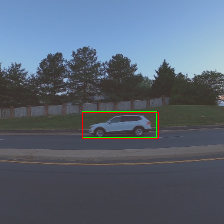

1.0 38 130 98 34
0.9999936819076538 38 130 90 33


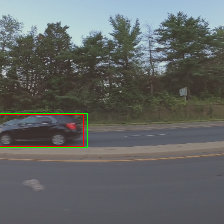

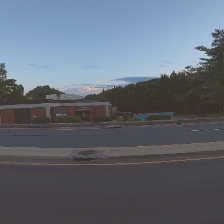

Epoch 50


100%|██████████| 23/23 [00:02<00:00,  8.65it/s]

3.26161369072076e-05
1.0 201 117 62 23
0.999993085861206 201 118 56 19


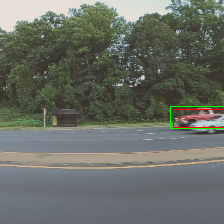

1.0 20 127 51 22
0.9998499155044556 20 125 55 19
1.0 102 128 99 41
0.9999793767929077 101 130 103 39


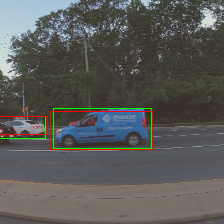

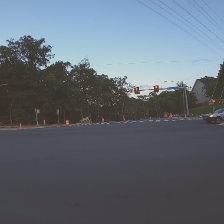

Epoch 51


100%|██████████| 23/23 [00:02<00:00,  8.66it/s]

3.7917198784745544e-05


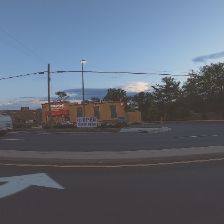

1.0 195 116 64 26
0.9997865557670593 195 118 76 33


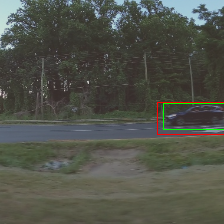

1.0 203 119 79 28
0.9999948740005493 204 121 90 34


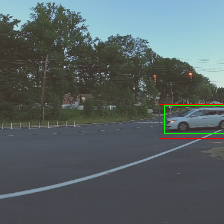

Epoch 52


100%|██████████| 23/23 [00:02<00:00,  8.60it/s]

3.638491801646761e-05


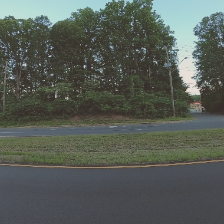

1.0 150 122 42 17
0.9967309236526489 148 119 28 10


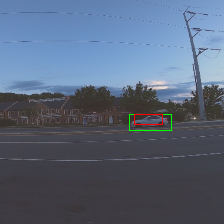

1.0 140 124 61 26
0.9999459981918335 138 124 56 24
1.0 78 132 110 36
0.9999947547912598 76 131 104 36


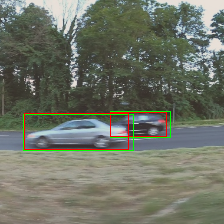

Epoch 53


100%|██████████| 23/23 [00:02<00:00,  8.30it/s]

0.00012374619038145403
1.0 117 121 50 20
0.9335724711418152 106 117 21 8
1.0 158 121 64 26
0.9998997449874878 156 121 72 29


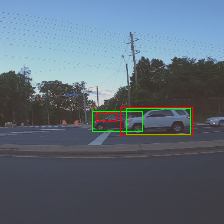

1.0 155 143 176 78
0.9998424053192139 153 146 165 67


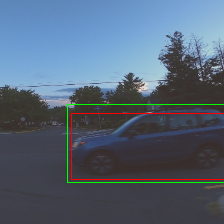

1.0 72 114 11 11
0.9931148886680603 68 111 5 4
1.0 89 132 107 34
0.9999785423278809 87 131 92 30


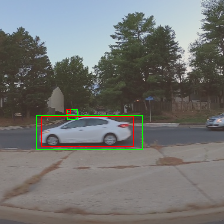

Epoch 54


100%|██████████| 23/23 [00:02<00:00,  8.64it/s]

0.0006281857958643029


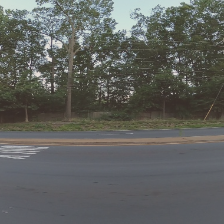

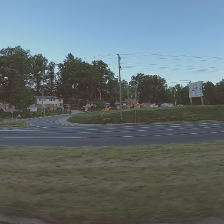

1.0 32 124 59 23
0.9998095631599426 35 124 68 25


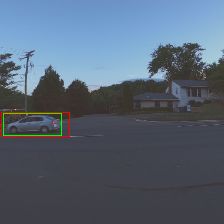

Epoch 55


100%|██████████| 23/23 [00:02<00:00,  8.65it/s]

0.0016272338698795268


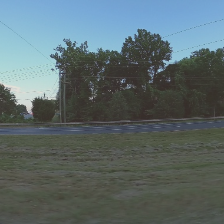

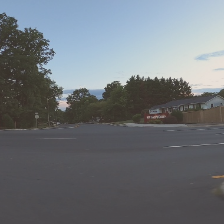

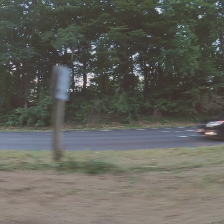

Epoch 56


100%|██████████| 23/23 [00:02<00:00,  8.69it/s]

0.0068241202186428655
1.0 160 128 101 39
0.955376386642456 163 129 41 10


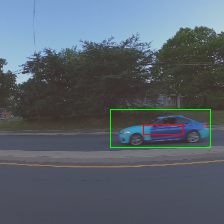

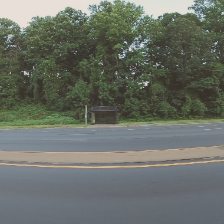

1.0 78 123 50 20
0.9995380640029907 79 123 35 16


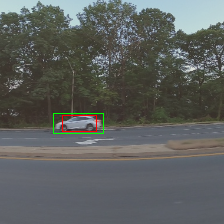

Epoch 57


100%|██████████| 23/23 [00:02<00:00,  8.57it/s]

0.003603564231130092


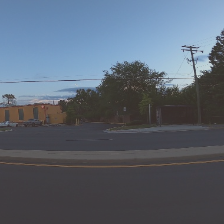

1.0 72 114 11 11
1.0 89 132 107 34
0.9999421834945679 91 130 127 27


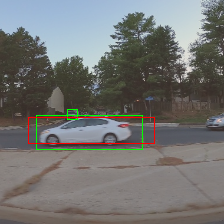

1.0 92 129 95 35
0.9884552955627441 92 129 69 16


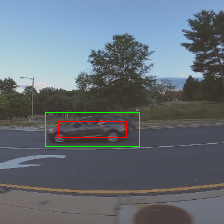

Epoch 58


100%|██████████| 23/23 [00:02<00:00,  8.40it/s]

0.00893179438603313
1.0 39 119 53 19
0.9792171716690063 39 121 31 23


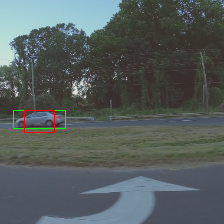

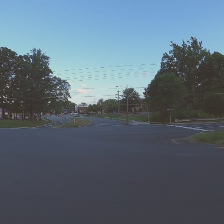

1.0 0 123 65 26
0.9982195496559143 3 119 45 26


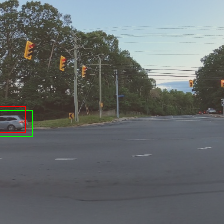

Epoch 59


100%|██████████| 23/23 [00:02<00:00,  8.65it/s]

0.0048277619998375685
1.0 115 128 108 40
0.9981316924095154 119 129 133 50


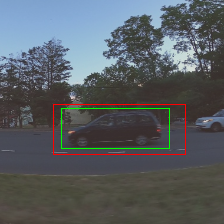

1.0 140 120 27 18
0.972090482711792 136 118 26 12


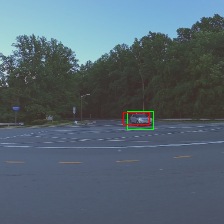

1.0 200 123 108 43
0.9966062307357788 200 118 71 30


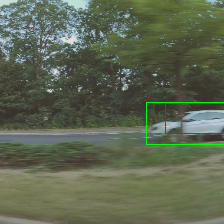

Epoch 60


100%|██████████| 23/23 [00:02<00:00,  8.57it/s]

0.002644126237694012


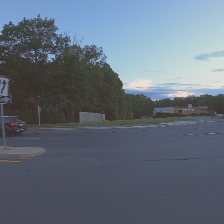

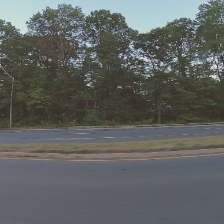

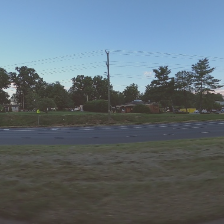

Epoch 61


100%|██████████| 23/23 [00:02<00:00,  8.63it/s]

0.0038254303040246114


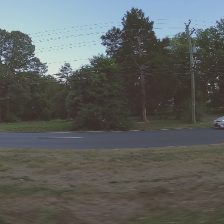

1.0 40 126 75 26
0.9997323155403137 46 125 75 26


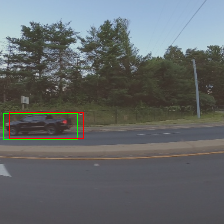

1.0 24 127 67 27
0.9990890026092529 19 125 86 28


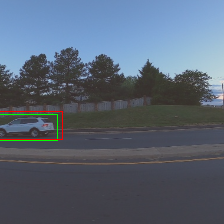

Epoch 62


100%|██████████| 23/23 [00:02<00:00,  8.33it/s]

0.002470599482362361
1.0 48 134 101 35
0.9999943971633911 51 132 66 20


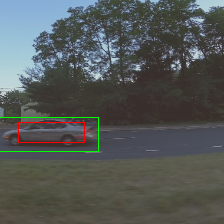

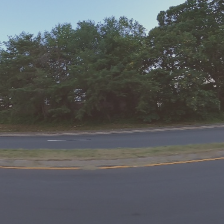

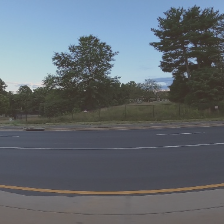

Epoch 63


100%|██████████| 23/23 [00:02<00:00,  8.44it/s]

0.0026780473126564175
1.0 81 124 75 33
0.9999678134918213 77 123 71 28


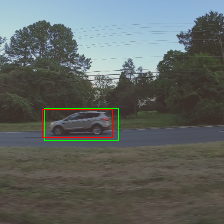

0.3084457218647003 2 100 3 2


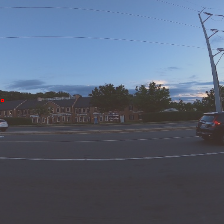

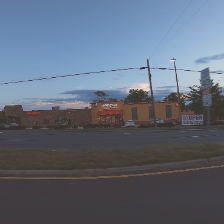

Epoch 64


100%|██████████| 23/23 [00:02<00:00,  8.65it/s]

0.0017159719908427771
1.0 40 126 75 26
0.999126136302948 39 125 59 20


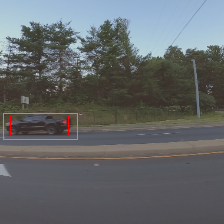

1.0 57 119 66 25
0.9874312877655029 48 117 37 17


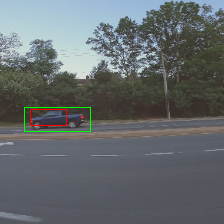

1.0 21 124 36 16
0.954477071762085 14 122 30 11
1.0 47 126 66 22
0.9842439889907837 46 125 65 21
1.0 178 119 48 21
0.9995633959770203 177 119 45 19


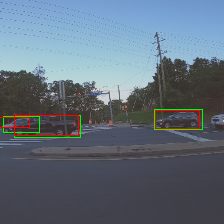

Epoch 65


100%|██████████| 23/23 [00:02<00:00,  8.59it/s]

0.000848675668037132


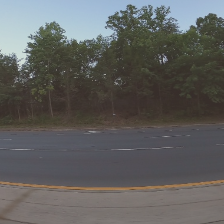

1.0 35 129 69 28
0.9947638511657715 36 129 87 27


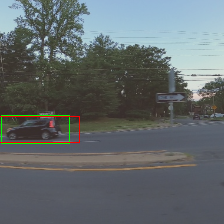

1.0 43 123 22 23
0.999972939491272 39 125 56 19


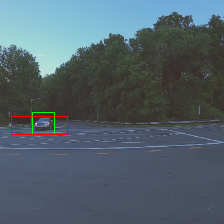

Epoch 66


100%|██████████| 23/23 [00:02<00:00,  8.48it/s]

0.0004902325321302709
1.0 211 114 73 29
0.9986936450004578 211 117 86 37


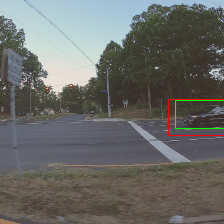

1.0 35 126 59 20
0.9945511221885681 35 125 63 28


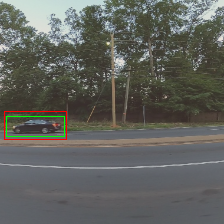

1.0 122 122 74 25
0.9999992847442627 122 122 94 28


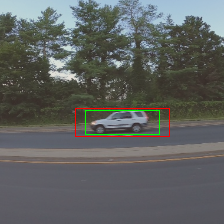

Epoch 67


100%|██████████| 23/23 [00:02<00:00,  8.54it/s]

0.0003060934291367986
1.0 200 123 108 43
0.999915599822998 202 118 82 34


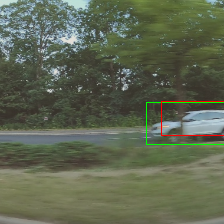

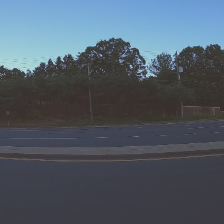

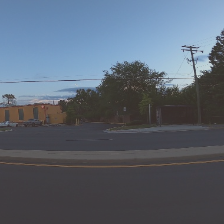

Epoch 68


100%|██████████| 23/23 [00:02<00:00,  8.69it/s]

0.00027751693889276004
1.0 179 124 52 28
0.9999862909317017 180 125 63 19


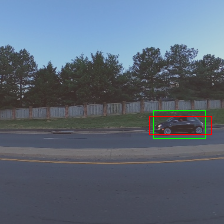

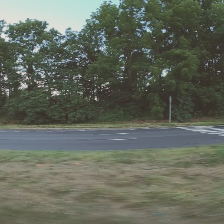

1.0 183 114 23 16
0.9998233914375305 182 119 40 20


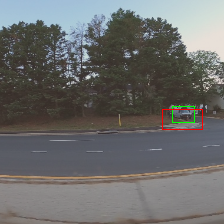

Epoch 69


100%|██████████| 23/23 [00:02<00:00,  8.55it/s]

0.00011161538571721631
1.0 141 119 49 24
0.9999961853027344 142 120 66 27


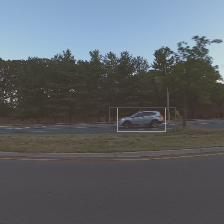

1.0 104 124 85 31
0.9999988079071045 105 125 77 24


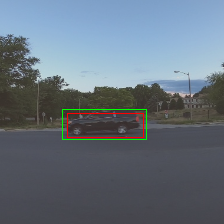

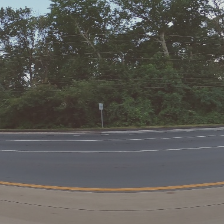

Epoch 70


100%|██████████| 23/23 [00:02<00:00,  8.66it/s]

7.859250494537106e-05
1.0 103 129 109 39
0.9999830722808838 101 130 112 47


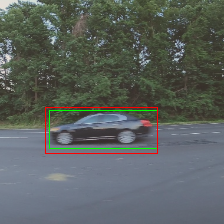

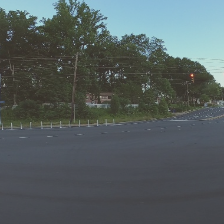

1.0 11 139 169 81
0.9987782835960388 13 142 138 70


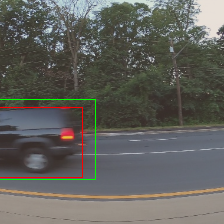

Epoch 71


100%|██████████| 23/23 [00:02<00:00,  8.13it/s]

8.238293958129361e-05
1.0 53 126 58 24
0.9992004036903381 54 124 57 18


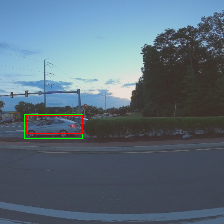

1.0 207 128 93 37
0.9995611310005188 207 129 92 36


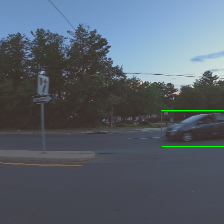

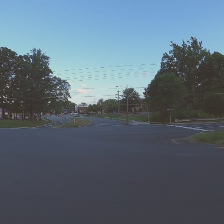

Epoch 72


100%|██████████| 23/23 [00:02<00:00,  8.63it/s]

6.51190993780999e-05
1.0 177 117 71 35
0.9999867677688599 177 117 68 27


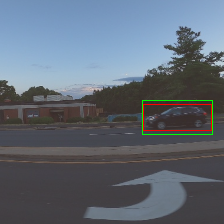

1.0 186 124 62 19
0.9999396800994873 183 123 64 22


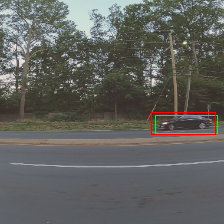

1.0 2 135 98 33
0.9998039603233337 4 133 107 34
1.0 150 129 69 26
0.999244213104248 150 129 75 27


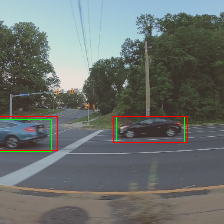

Epoch 73


100%|██████████| 23/23 [00:02<00:00,  8.63it/s]

5.055477223599471e-05


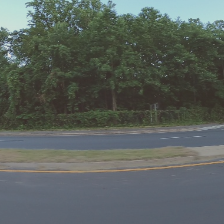

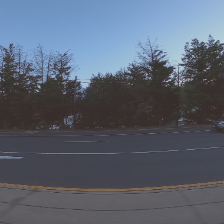

1.0 42 130 61 25
0.9994334578514099 45 128 63 25


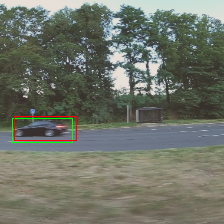

Epoch 74


100%|██████████| 23/23 [00:02<00:00,  8.61it/s]

4.892480264179935e-05


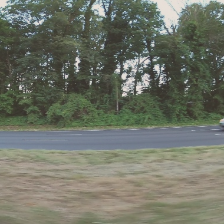

1.0 103 129 109 39
0.9999982118606567 106 130 114 42


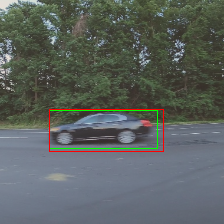

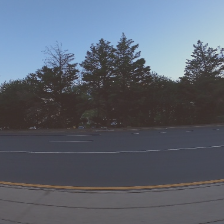

Epoch 75


100%|██████████| 23/23 [00:02<00:00,  8.45it/s]

4.507874991363876e-05
1.0 138 118 56 27
0.9998643398284912 138 117 48 26


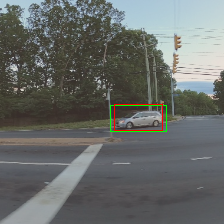

1.0 52 124 62 20
0.9999997615814209 51 123 56 21


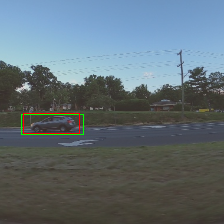

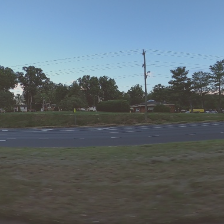

Epoch 76


100%|██████████| 23/23 [00:02<00:00,  8.50it/s]

4.1678492577731326e-05


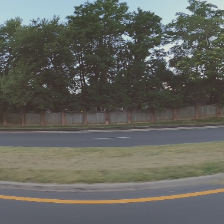

1.0 44 121 75 26
0.9999988079071045 46 120 72 30
1.0 146 121 59 17
0.9999994039535522 146 118 55 21


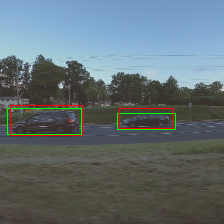

1.0 68 121 64 24
0.9999867677688599 67 120 59 22


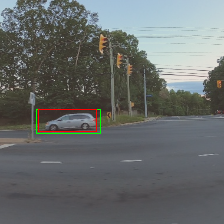

Epoch 77


100%|██████████| 23/23 [00:02<00:00,  8.69it/s]

3.855362213115491e-05
1.0 114 132 110 45
0.9999945163726807 116 132 120 48


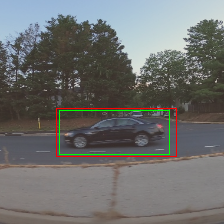

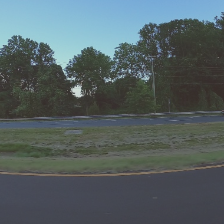

1.0 201 119 77 31
0.9999078512191772 201 118 67 32
1.0 3 132 91 32
0.9998583793640137 3 132 97 38


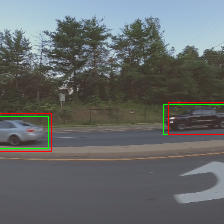

Epoch 78


100%|██████████| 23/23 [00:02<00:00,  8.76it/s]

3.7111801050385743e-05
1.0 177 122 72 32
0.9999943971633911 179 122 66 30


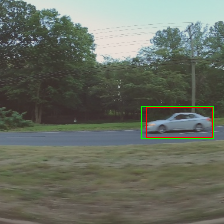

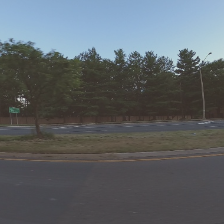

1.0 160 128 101 39
0.9999996423721313 163 130 96 41


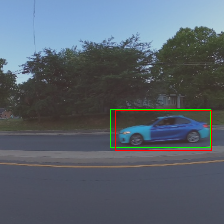

Epoch 79


100%|██████████| 23/23 [00:02<00:00,  8.58it/s]

3.695326212555697e-05


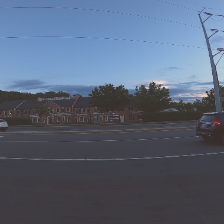

1.0 110 124 57 21
0.9999994039535522 107 124 55 23


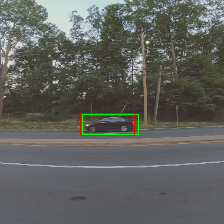

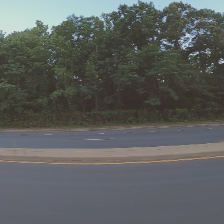

Epoch 80


100%|██████████| 23/23 [00:02<00:00,  8.23it/s]

2.9305883641506586e-05
1.0 96 132 93 36
0.9999841451644897 99 133 84 37


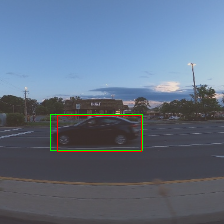

1.0 38 130 98 34
0.9999998807907104 40 130 87 32


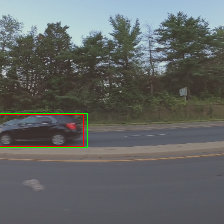

1.0 168 120 122 55
0.9999219179153442 167 121 126 60


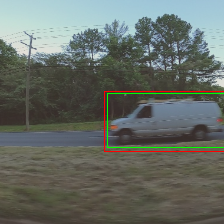

Epoch 81


100%|██████████| 23/23 [00:02<00:00,  8.64it/s]

3.151500641251914e-05


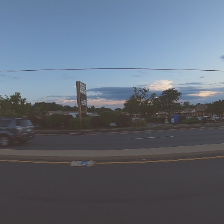

1.0 200 120 64 32
0.9999825954437256 202 121 70 30
1.0 66 129 102 40
0.9999945163726807 67 130 93 33


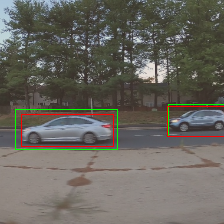

1.0 125 123 84 31
0.9999922513961792 124 123 84 32


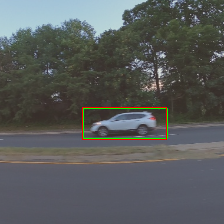

Epoch 82


100%|██████████| 23/23 [00:02<00:00,  8.68it/s]

3.944170471779375e-05


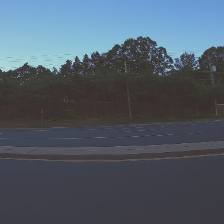

1.0 92 121 27 21
0.9999747276306152 92 123 29 21


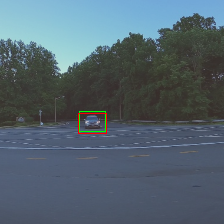

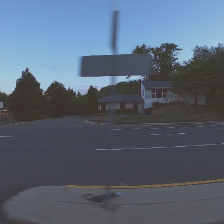

Epoch 83


100%|██████████| 23/23 [00:02<00:00,  8.78it/s]

3.290635702243257e-05


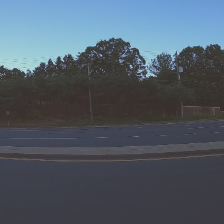

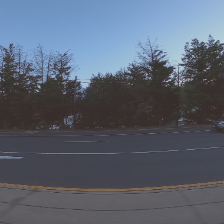

1.0 45 125 54 18
0.9999951124191284 45 125 53 22
1.0 179 124 69 27
0.9999998807907104 180 122 68 28


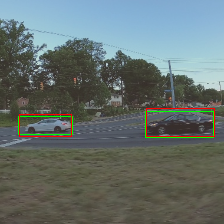

Epoch 84


100%|██████████| 23/23 [00:02<00:00,  8.59it/s]

2.9411908184082005e-05


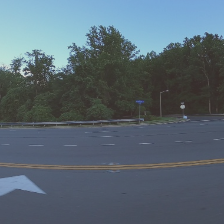

1.0 27 126 67 26
0.9999964237213135 28 126 67 22


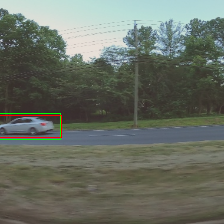

1.0 0 124 38 23
0.9999216794967651 1 125 40 24


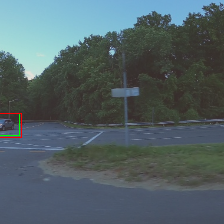

Epoch 85


100%|██████████| 23/23 [00:02<00:00,  8.35it/s]

2.4545267320797354e-05
1.0 17 132 88 32
0.9999884366989136 17 133 92 36


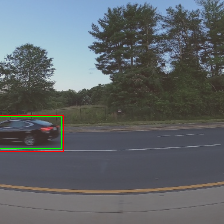

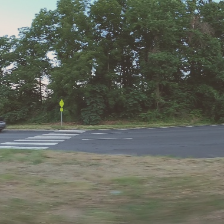

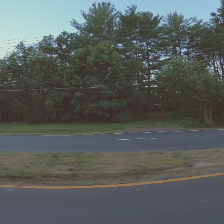

Epoch 86


100%|██████████| 23/23 [00:02<00:00,  8.63it/s]

2.0849015052827664e-05


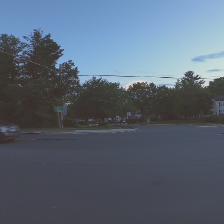

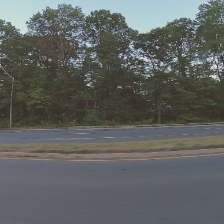

1.0 80 129 64 31
0.9999977350234985 80 128 69 27


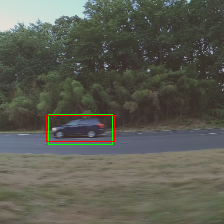

Epoch 87


100%|██████████| 23/23 [00:02<00:00,  8.61it/s]

2.2462263151955202e-05
1.0 200 118 48 21
0.9995447993278503 201 118 40 19
1.0 131 136 100 42
0.9999727010726929 131 138 102 38


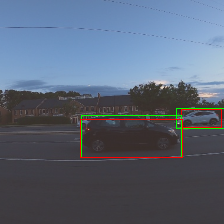

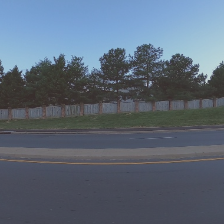

1.0 81 124 75 33
0.9999969005584717 80 123 74 34


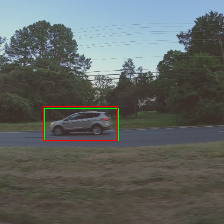

Epoch 88


100%|██████████| 23/23 [00:02<00:00,  8.61it/s]

2.8215425078562237e-05


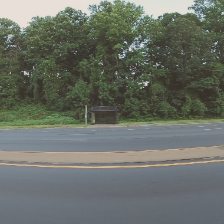

1.0 153 121 57 22
0.9999945163726807 152 121 56 26
1.0 54 131 102 35
0.9998239874839783 52 131 113 45


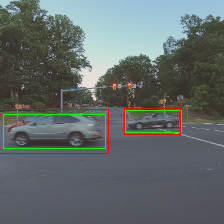

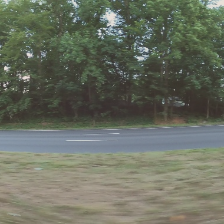

Epoch 89


100%|██████████| 23/23 [00:02<00:00,  8.31it/s]

3.087458389927633e-05
1.0 123 124 117 38
0.9997088313102722 123 124 102 35
1.0 221 118 61 27
0.9996328353881836 220 118 61 27


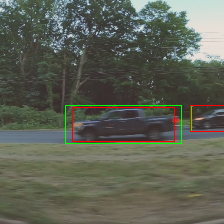

1.0 106 123 65 28
0.9999998807907104 105 122 59 25


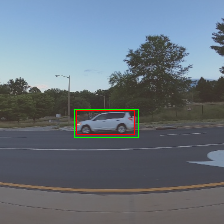

1.0 196 116 48 24
0.996705949306488 197 116 45 20


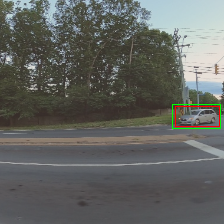

Epoch 90


100%|██████████| 23/23 [00:02<00:00,  8.64it/s]

2.8045277007470798e-05
1.0 43 123 22 23
0.9999960660934448 44 122 37 23


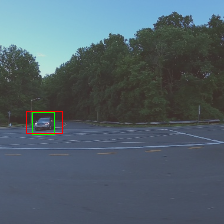

1.0 77 124 62 26
0.9999984502792358 77 125 80 33


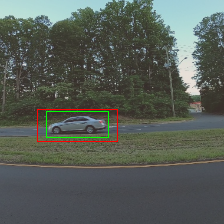

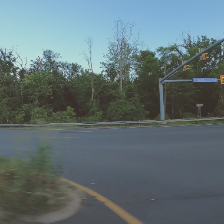

Epoch 91


100%|██████████| 23/23 [00:02<00:00,  8.67it/s]

2.4898708785337437e-05


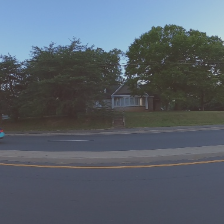

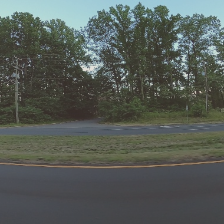

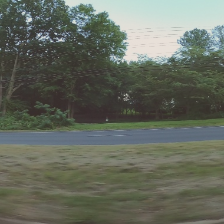

Epoch 92


100%|██████████| 23/23 [00:02<00:00,  8.52it/s]

1.947399473663055e-05


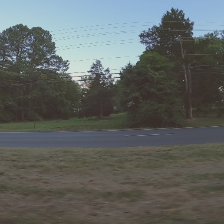

1.0 114 132 110 45
0.9999991655349731 114 131 110 47


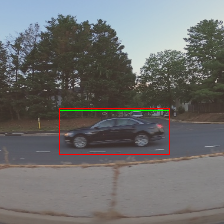

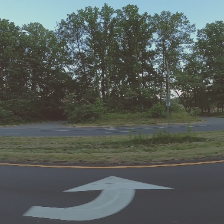

Epoch 93


100%|██████████| 23/23 [00:02<00:00,  8.41it/s]

1.984887848780288e-05


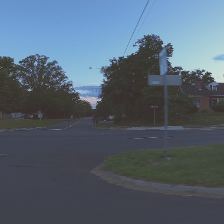

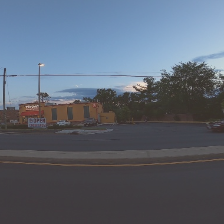

1.0 43 128 72 25
0.9999303817749023 45 129 95 31
1.0 77 135 97 31
0.9999964237213135 76 136 92 29


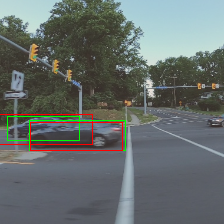

Epoch 94


100%|██████████| 23/23 [00:02<00:00,  8.18it/s]

2.494187712094888e-05
1.0 48 134 101 35
0.9999994039535522 50 133 96 30


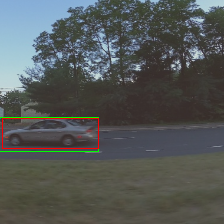

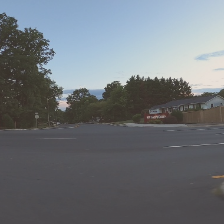

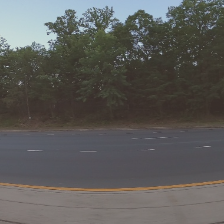

Epoch 95


100%|██████████| 23/23 [00:02<00:00,  8.35it/s]

2.3105729071729634e-05
1.0 24 128 59 23
0.9999339580535889 21 129 55 21


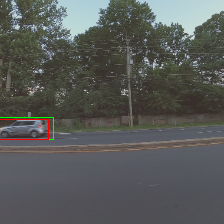

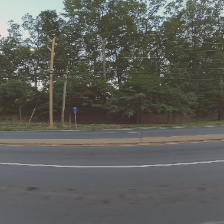

1.0 113 124 59 24
0.9999997615814209 114 124 64 25


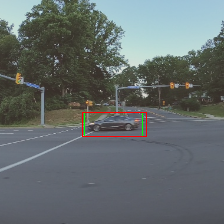

Epoch 96


100%|██████████| 23/23 [00:02<00:00,  8.58it/s]

2.4871767772824768e-05
1.0 20 127 51 22
0.9991480112075806 16 126 50 21
1.0 102 128 99 41
0.9999202489852905 103 130 86 35


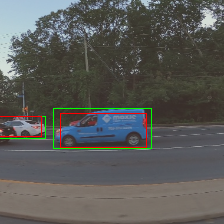

1.0 125 123 84 31
0.9999301433563232 123 122 82 32


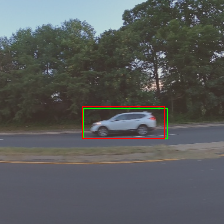

1.0 140 124 61 26
0.9999918937683105 138 124 66 30
1.0 78 132 110 36
0.9998961687088013 76 133 108 38


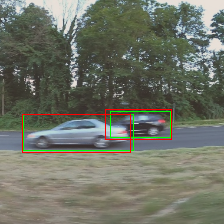

Epoch 97


100%|██████████| 23/23 [00:02<00:00,  8.55it/s]

2.5961433137759425e-05
1.0 92 129 95 35
0.9999756813049316 93 130 79 35


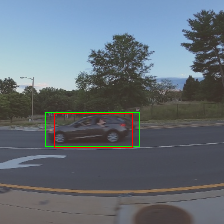

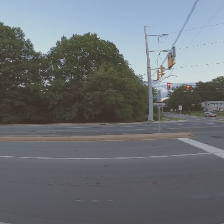

1.0 177 117 71 35
0.9999969005584717 178 118 71 32


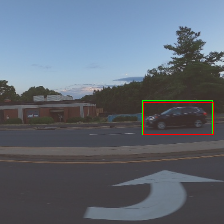

Epoch 98


100%|██████████| 23/23 [00:02<00:00,  8.23it/s]

2.309019944969686e-05


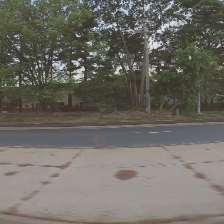

1.0 44 121 75 26
0.9999994039535522 44 122 73 30
1.0 146 121 59 17
0.9999998807907104 146 120 56 19


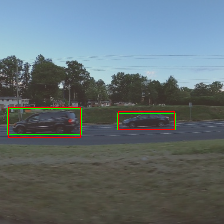

1.0 37 127 66 25
0.9984121322631836 37 126 69 27


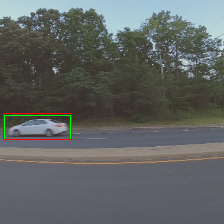

Epoch 99


100%|██████████| 23/23 [00:02<00:00,  8.51it/s]

2.0171660371883974e-05
1.0 49 123 60 21
0.9999985694885254 48 123 63 26


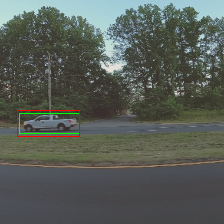

1.0 186 120 55 21
0.9996102452278137 186 121 58 25


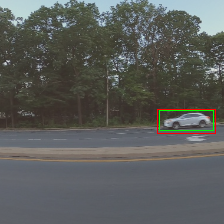

1.0 208 124 67 26
0.999983549118042 205 124 69 28


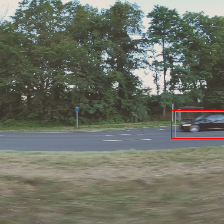

In [ ]:
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
bce_loss = torch.nn.BCELoss()

for epoch in range(100):
  print('Epoch', epoch)
  loss_sum = 0.0
  n=0
  for x, y in tqdm(dataloader):
    y = y.cuda()

    optimizer.zero_grad()

    output = model(x.cuda())

    loss1 = bce_loss(output[:,4], y[:,4])
    loss2 = torch.nn.functional.mse_loss(output[:,:2], y[:,:2])
    loss3 = torch.nn.functional.mse_loss(torch.sqrt(output[:,2:4]), torch.sqrt(y[:,2:4]))

    #print(loss1.shape, loss2.shape, loss3.shape)

    loss = loss1 + loss2 + loss3

    loss_sum += loss.item()
    n+=1

    loss.backward()
    optimizer.step()

  print(loss_sum/n)

  for j in range(len(x)):
    # convert pixel color to 0-255
    img = (np.transpose(x[j].numpy(), (1,2,0))*40.0+127.0).astype(np.uint8).copy()
    for ki in range(7):
      for kj in range(7):
        k = ki*7+kj
        px, py, pw, ph, pc = y[j,:,k//7,k%7]
        if pc.item() > 0.3:
          # center of bounding box
          cx = (k%7)*32 + int(px*31+0.5)
          cy = (k//7)*32 + int(py*31+0.5)
          # dimensions of bounding box
          w = int(pw*224+0.5)
          h = int(ph*224+0.5)
          print(pc.item(), cx, cy, w, h)
          cv2.rectangle(img, (cx-w//2,cy-h//2), (cx+w//2,cy+h//2), (0,255,0), 1)

        px, py, pw, ph, pc = output[j,:,k//7,k%7]
        if pc.item() > 0.3:
          # center of bounding box
          cx = (k%7)*32 + int(px*31+0.5)
          cy = (k//7)*32 + int(py*31+0.5)
          # dimensions of bounding box
          w = int(pw*224+0.5)
          h = int(ph*224+0.5)
          print(pc.item(), cx, cy, w, h)
          cv2.rectangle(img, (cx-w//2,cy-h//2), (cx+w//2,cy+h//2), (0,0,255), 1)
    cv2_imshow(img)

In [ ]:
import torchsummary

torchsummary.summary(backbone, (3,224,224))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]          36,864
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
             ReLU-10           [-1, 64, 56, 56]               0
       BasicBlock-11           [-1, 64, 56, 56]               0
           Conv2d-12           [-1, 64, 56, 56]          36,864
      BatchNorm2d-13           [-1, 64, 56, 56]             128
             ReLU-14           [-1, 64,